In [1]:
"""
https://chat.openai.com/share/45e1a02e-0808-49b8-ac2c-f95f54b05138

https://chat.openai.com/share/f450167a-b09e-4a2b-a567-fb36265e4216

https://chat.openai.com/share/f6717d7b-d070-45cf-8c14-8ec32d7a9413
"""
import numpy as np
import mat73
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader
from sklearn.decomposition import PCA
from torch.utils.data import random_split
import pickle

class TemperatureSalinityDataset(torch.utils.data.Dataset):
    """
    Custom dataset for temperature and salinity profiles.
    
    Attributes:
    - TEMP: Temperature profiles matrix.
    - SAL: Salinity profiles matrix.
    - SSH: Sea Surface Height vector.
    - pca_temp: PCA model for temperature profiles.
    - pca_sal: PCA model for salinity profiles.
    - temp_pcs: Transformed temperature profiles using PCA.
    - sal_pcs: Transformed salinity profiles using PCA.
    """
    def __init__(self, path, n_components=15, input_params=None):
        """
        Args:
        - path (str): File path to the dataset.
        - n_components (int): Number of PCA components to retain.
        """
        data = mat73.loadmat(path)
        # Filtering profiles
        valid_mask = self._get_valid_mask(data)
        self.TEMP, self.SAL, self.SSH, self.TIME, self.LAT, self.LON = self._filter_and_fill_data(data, valid_mask)
        # Applying PCA
        self.temp_pcs, self.pca_temp = self._apply_pca(self.TEMP, n_components)
        self.sal_pcs, self.pca_sal = self._apply_pca(self.SAL, n_components)
        
        # Define which parameters to include
        if input_params is None:
            input_params = {
                "time": False,
                "lat": False,
                "lon": False,
                "sst": True,  # First value of temperature
                "sss": True,
                "ssh": True
            }

        self.input_params = input_params

    def __getitem__(self, idx):
        """
        Args:
        - idx (int): Index of the profile.

        Returns:
        - tuple: input values and concatenated PCA components for temperature and salinity.
        """
        
        inputs = []
        
        if self.input_params["time"]:
            inputs.append(np.cos(self.TIME[idx]%365))  # assuming TIME is available in your dataset
        
        if self.input_params["lat"]:
            inputs.append(self.LAT[idx])  # assuming LAT is available in your dataset

        if self.input_params["lon"]:
            inputs.append(self.LON[idx])  # assuming LON is available in your dataset
            
        if self.input_params["sss"]:
            inputs.append(self.SAL[0, idx])

        if self.input_params["sst"]:
            inputs.append(self.TEMP[0, idx])  # First value of temperature profile
        
        if self.input_params["ssh"]:
            inputs.append(self.SSH[idx])
            
        inputs_tensor = torch.tensor(inputs, dtype=torch.float32)
        profiles = torch.tensor(np.hstack([self.temp_pcs[:, idx], self.sal_pcs[:, idx]]), dtype=torch.float32)
        
        return inputs_tensor, profiles
    
    def _get_valid_mask(self, data):
        """Internal method to get mask of valid profiles based on missing values."""
        temp_mask = np.sum(np.isnan(data['TEMP']), axis=0) <= 10
        sal_mask = np.sum(np.isnan(data['SAL']), axis=0) <= 10
        return np.logical_and(temp_mask, sal_mask)
    
    def _filter_and_fill_data(self, data, valid_mask):
        """Internal method to filter data using the mask and fill missing values."""
        TEMP = data['TEMP'][:, valid_mask]
        SAL = data['SAL'][:, valid_mask]
        SSH = data['SH1950'][valid_mask]
        TIME = data['TIME'][valid_mask]
        LAT = data['LAT'][valid_mask]
        LON = data['LON'][valid_mask]
        
        # Fill missing values using interpolation
        for i in range(TEMP.shape[1]):
            valid_temp_idx = np.where(~np.isnan(TEMP[:, i]))[0]
            TEMP[:, i] = np.interp(range(TEMP.shape[0]), valid_temp_idx, TEMP[valid_temp_idx, i])
            valid_sal_idx = np.where(~np.isnan(SAL[:, i]))[0]
            SAL[:, i] = np.interp(range(SAL.shape[0]), valid_sal_idx, SAL[valid_sal_idx, i])
            
        return TEMP, SAL, SSH, TIME, LAT, LON

    def _apply_pca(self, data, n_components):
        """Internal method to apply PCA transformation to the data."""
        pca = PCA(n_components=n_components)
        pcs = pca.fit_transform(data.T).T
        return pcs, pca
    
    def __len__(self):
        """Returns number of profiles in the dataset."""
        return self.TEMP.shape[1]
    
    def inverse_transform(self, pcs):
        """
        Inverse the PCA transformation.

        Args:
        - pcs (numpy.ndarray): Concatenated PCA components for temperature and salinity.

        Returns:
        - tuple: Inversed temperature and salinity profiles.
        """
        temp_profiles = self.pca_temp.inverse_transform(pcs[:, :n_components]).T
        sal_profiles = self.pca_sal.inverse_transform(pcs[:, n_components:]).T
        return temp_profiles, sal_profiles
    
    def get_profiles(self, indices, pca_approx=False):
        """
        Returns temperature and salinity profiles for the given indices.

        Args:
        - indices (list or numpy.ndarray): List of indices for which profiles are needed.
        - pca_approx (bool): Flag to return PCA approximated profiles if True, 
                             or original profiles if False.

        Returns:
        - numpy.ndarray: concatenated temperature and salinity profiles in the required format for visualization.
        """
        if pca_approx:
            # Concatenate temp and sal PCA components for the given indices
            concatenated_pcs = np.hstack([self.temp_pcs[:, indices].T, self.sal_pcs[:, indices].T])
            # Obtain PCA approximations using the concatenated components
            temp_profiles, sal_profiles = self.inverse_transform(concatenated_pcs)
        else:
            temp_profiles = self.TEMP[:, indices]
            sal_profiles = self.SAL[:, indices]

        # Stack along the third dimension
        profiles_array = np.stack([temp_profiles, sal_profiles], axis=1)

        return profiles_array
    

class PredictionModel(nn.Module):
    """
    Neural Network model for predicting temperature and salinity profiles based on sea surface height (SSH).

    Attributes:
    - model (nn.Sequential): Sequential model containing layers defined by `layers_config`.

    Parameters:
    - input_dim (int): Dimension of the input feature(s). Default is 1 (for SSH).
    - layers_config (list of int): List where each element represents the number of neurons in 
                                   a respective layer. Default is [512, 256].
    - output_dim (int): Dimension of the output. Default is 30 (15 components for TEMP and 15 for SAL).

    Methods:
    - forward(x: torch.Tensor) -> torch.Tensor: Forward pass through the model.
    """

    def __init__(self, input_dim=1, layers_config=[512, 256], output_dim=30, dropout_prob = 0.5):
        super(PredictionModel, self).__init__()
        
        # Construct layers based on the given configuration
        layers = []
        prev_dim = input_dim
        for neurons in layers_config:
            layers.append(nn.Linear(prev_dim, neurons))
            layers.append(nn.ReLU())
            layers.append(nn.Dropout(dropout_prob)) # added dropout
            prev_dim = neurons
        layers.append(nn.Linear(prev_dim, output_dim))
        
        self.model = nn.Sequential(*layers)      
    
    def forward(self, x):
        """
        Forward pass through the model.

        Parameters:
        - x (torch.Tensor): Input tensor of shape (batch_size, input_dim).

        Returns:
        - torch.Tensor: Model's predictions of shape (batch_size, output_dim).
        """
        return self.model(x)
    
def split_dataset(dataset, train_size, val_size, test_size):
    """
    Splits the dataset into training, validation, and test sets.
    
    Parameters:
    - dataset: The entire dataset to be split.
    - train_size, val_size, test_size: Proportions for splitting. They should sum to 1.
    
    Returns:
    - train_dataset, val_dataset, test_dataset: Split datasets.
    """
    total_size = len(dataset)
    train_len = int(total_size * train_size)
    val_len = int(total_size * val_size)
    test_len = total_size - train_len - val_len

    return random_split(dataset, [train_len, val_len, test_len])

def train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs=100, patience=10):
    """
    Train the model with early stopping and CUDA support.

    Parameters:
    - model: the PyTorch model.
    - train_loader: the DataLoader for training data.
    - val_loader: the DataLoader for validation data.
    - criterion: the loss function.
    - optimizer: the optimizer.
    - device: device to which data and model should be moved before training.
    - epochs: number of total epochs to train.
    - patience: number of epochs to wait for improvement before stopping.

    Returns:
    - model: trained model.
    """
    model.to(device)
    best_val_loss = float('inf')
    best_weights = None  # To store best model weights
    no_improve_count = 0

    for epoch in range(epochs):
        model.train()
        running_train_loss = 0.0
        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            
            optimizer.zero_grad()

            # Forward pass
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            
            # Backward pass and optimization
            loss.backward()
            optimizer.step()
            
            running_train_loss += loss.item()

        avg_train_loss = running_train_loss / len(train_loader)
        
        # Validation loss
        avg_val_loss = evaluate_model(model, val_loader, criterion, device)
        print(f"Epoch [{epoch + 1}/{epochs}] Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

        # Check for early stopping
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            best_weights = model.state_dict()  # Save the model weights
            no_improve_count = 0
        else:
            no_improve_count += 1
            if no_improve_count >= patience:
                print(f"Early stopping at Epoch {epoch + 1}")
                break

    model.load_state_dict(best_weights)  # Load the best model weights
    return model

def evaluate_model(model, dataloader, criterion, device):
    """
    Evaluate the model on the provided data with CUDA support.

    Parameters:
    - model: the PyTorch model.
    - dataloader: the DataLoader for evaluation data.
    - criterion: the loss function.
    - device: device to which data and model should be moved before evaluation.

    Returns:
    - avg_loss: average loss over the dataset.
    """
    model.to(device)
    model.eval()
    running_loss = 0.0
    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)
            
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            running_loss += loss.item()

    avg_loss = running_loss / len(dataloader)
    return avg_loss

def get_predictions(model, dataloader, device):
    """
    Get model's predictions on the provided data with CUDA support.

    Parameters:
    - model: the PyTorch model.
    - dataloader: the DataLoader for the data.
    - device: device to which data and model should be moved before getting predictions.

    Returns:
    - predictions: model's predictions.
    """
    model.to(device)
    model.eval()
    predictions = []

    with torch.no_grad():
        for inputs in dataloader:
            inputs = inputs[0].to(device)  # Getting only the input features, ignoring labels
            outputs = model(inputs)
            predictions.extend(outputs.cpu().numpy())

    return np.array(predictions)

def visualize_results_with_original(true_values, pca_approx, predicted_values, num_samples=5):
    """
    Visualize the true vs. predicted vs. PCA approximated values for a sample of profiles.

    Parameters:
    - true_values: ground truth temperature and salinity profiles.
    - pca_approx: PCA approximated temperature and salinity profiles.
    - predicted_values: model's predicted temperature and salinity profiles.
    - num_samples: number of random profiles to visualize.

    Returns:
    - None (plots the results).
    """
    n_depths = 2001
    depth_levels = np.arange(n_depths)
    population_size = true_values.shape[2]
    
    if num_samples == population_size:
        indices = np.arange(num_samples)
    else:
        indices = np.random.choice(int(population_size), num_samples, replace=False)

    for idx in indices:
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))
        
        # Temperature profile
        axs[0].plot(pca_approx[:, 0, idx], depth_levels, label="PCA Approximation")
        axs[0].plot(true_values[:,0, idx], depth_levels, label="Original")
        axs[0].plot(predicted_values[0][:, idx], depth_levels, label="NN Predicted")
        axs[0].invert_yaxis()  # To have the surface (depth=0) on top
        axs[0].set_title(f"Temperature Profile {idx}")
        axs[0].set_ylabel("Depth Level")
        axs[0].set_xlabel("Temperature")
        axs[0].legend(loc='lower right')
        axs[0].grid()

        # Salinity profile
        axs[1].plot(pca_approx[:, 1, idx], depth_levels, label="PCA Approximation")
        axs[1].plot(true_values[:,1, idx], depth_levels, label="Original")
        axs[1].plot(predicted_values[1][:, idx], depth_levels, label="Predicted")
        axs[1].invert_yaxis()  # To have the surface (depth=0) on top
        axs[1].set_title(f"Salinity Profile {idx}")
        axs[1].set_ylabel("Depth Level")
        axs[1].set_xlabel("Salinity")
        axs[1].legend(loc='lower right')
        axs[1].grid()

        plt.tight_layout()
        plt.show()
        
def predict_with_numpy(model, numpy_input, device="cuda"):
    # Convert numpy array to tensor
    tensor_input = torch.tensor(numpy_input, dtype=torch.float32)
    
    # Check if CUDA is available and move tensor to the appropriate device
    if device == "cuda" and torch.cuda.is_available():
        tensor_input = tensor_input.cuda()
        model = model.cuda()
    
    # Make sure the model is in evaluation mode
    model.eval()
    
    # Make predictions
    with torch.no_grad():
        predictions = model(tensor_input)
    
    # Convert predictions back to numpy (if on GPU, move to CPU first)
    numpy_predictions = predictions.cpu().numpy()
    
    return numpy_predictions

def inverse_transform(pcs, pca_temp, pca_sal, n_components):
    """
    Inverse the PCA transformation.

    Args:
    - pcs (numpy.ndarray): Concatenated PCA components for temperature and salinity.
    - pca_temp, pca_sal: PCA models for temperature and salinity respectively.
    - n_components (int): Number of PCA components.

    Returns:
    - tuple: Inversed temperature and salinity profiles.
    """
    temp_profiles = pca_temp.inverse_transform(pcs[:, :n_components]).T
    sal_profiles = pca_sal.inverse_transform(pcs[:, n_components:]).T
    return temp_profiles, sal_profiles


Number of profiles: 4458
Parameters used: sst, ssh
Number of components used: 16 x2
Batch size: 128
Learning rate: 0.001
Dropout probability: 0.2
Train/test/validation split: 0.8/0.1/0.1
Layer configuration: [256, 256]

Epoch [1/500] Train Loss: 72.8532 | Val Loss: 17.2700
Epoch [2/500] Train Loss: 23.9176 | Val Loss: 16.0396
Epoch [3/500] Train Loss: 19.8262 | Val Loss: 15.5503
Epoch [4/500] Train Loss: 18.8780 | Val Loss: 15.3159
Epoch [5/500] Train Loss: 18.2998 | Val Loss: 15.1876
Epoch [6/500] Train Loss: 17.8227 | Val Loss: 15.0980
Epoch [7/500] Train Loss: 17.1870 | Val Loss: 15.1007
Epoch [8/500] Train Loss: 16.9314 | Val Loss: 14.9661
Epoch [9/500] Train Loss: 16.7286 | Val Loss: 14.7559
Epoch [10/500] Train Loss: 16.6981 | Val Loss: 14.8463
Epoch [11/500] Train Loss: 16.4548 | Val Loss: 14.7446
Epoch [12/500] Train Loss: 16.3252 | Val Loss: 14.7254
Epoch [13/500] Train Loss: 16.2110 | Val Loss: 14.7095
Epoch [14/500] Train Loss: 16.1193 | Val Loss: 14.7516
Epoch [15/500] Tra

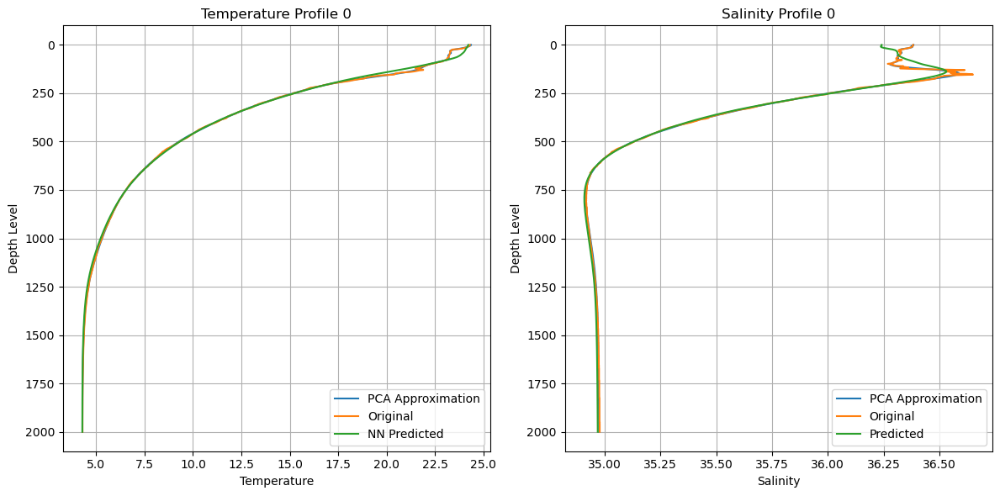

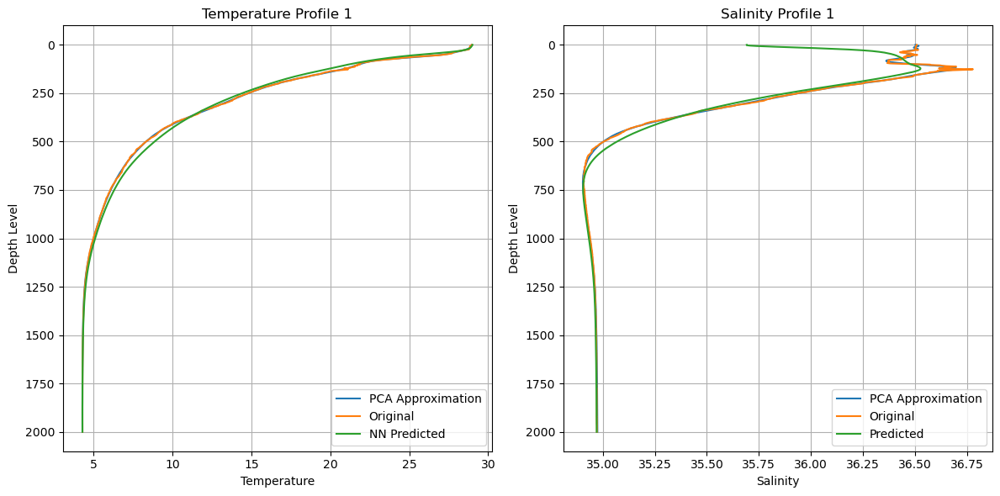

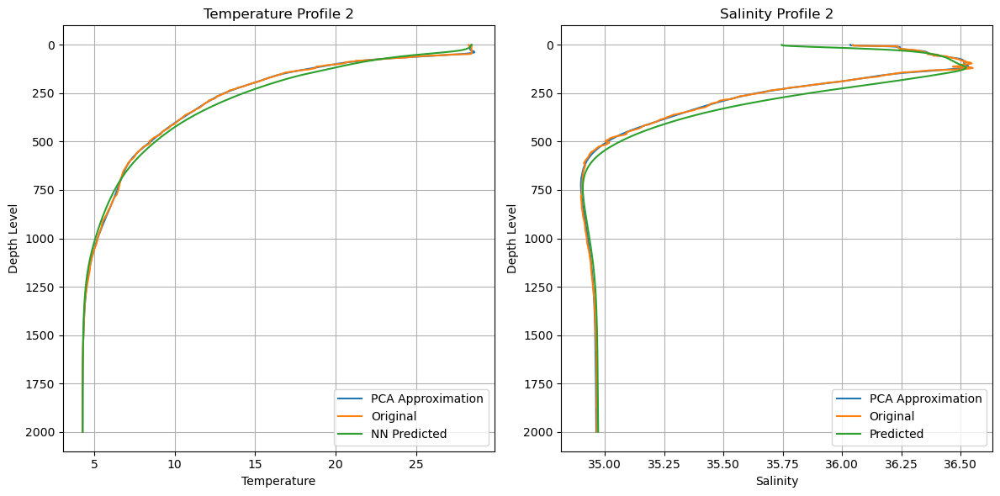

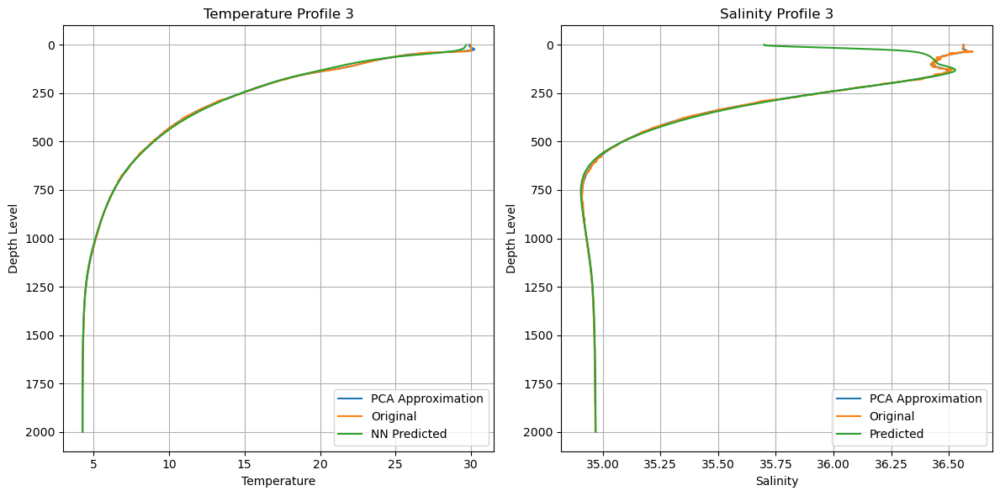

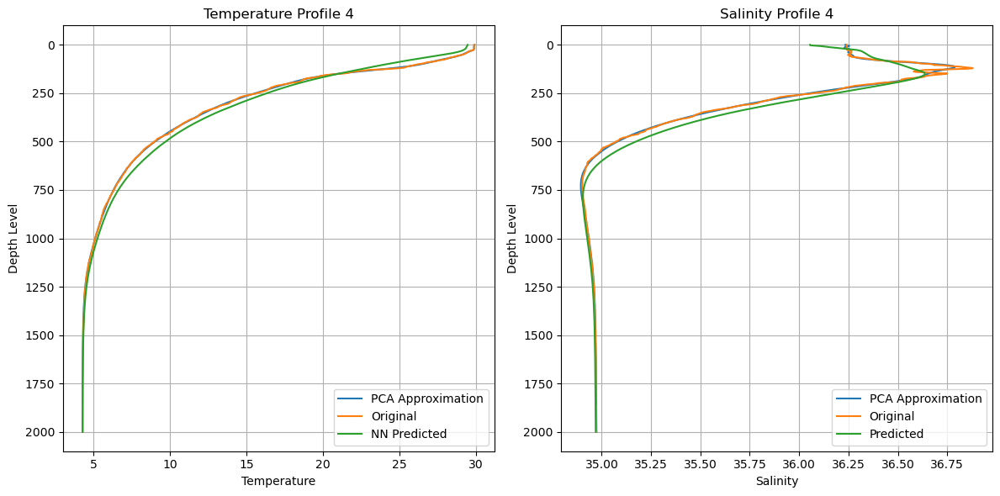

...

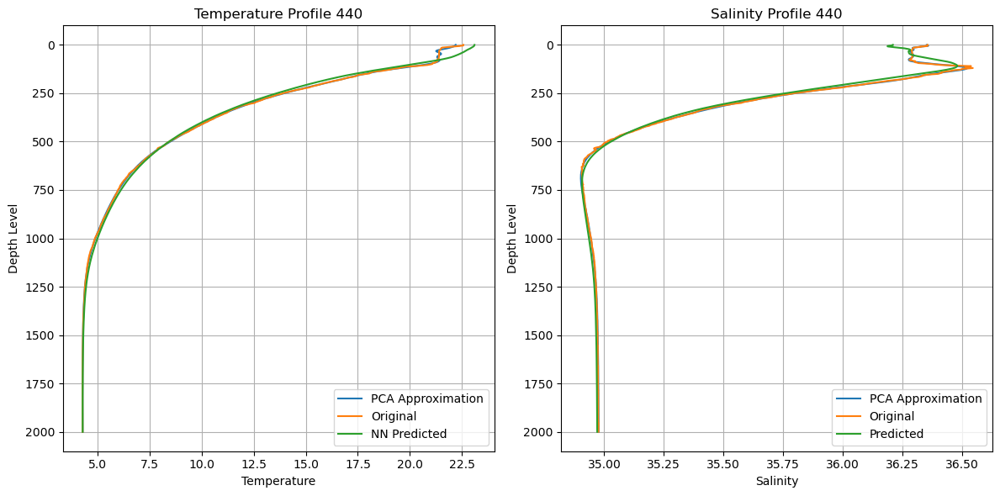

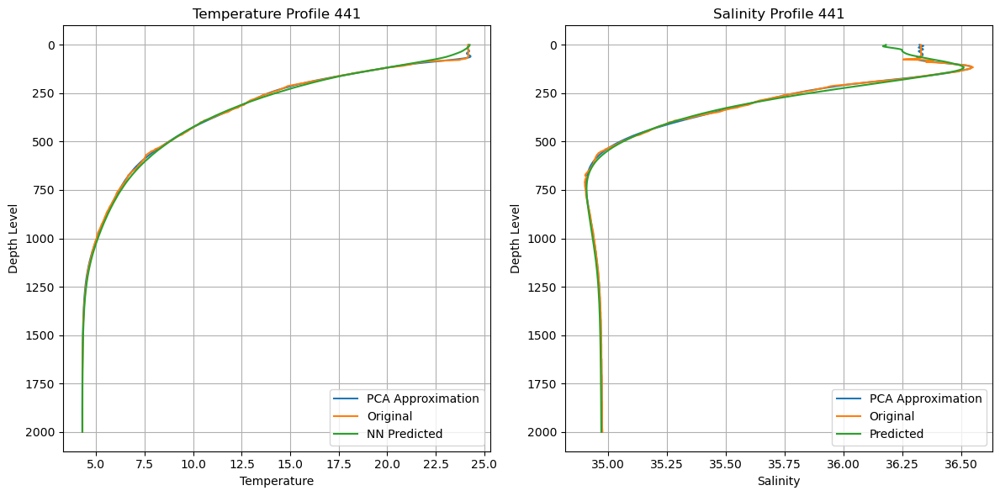

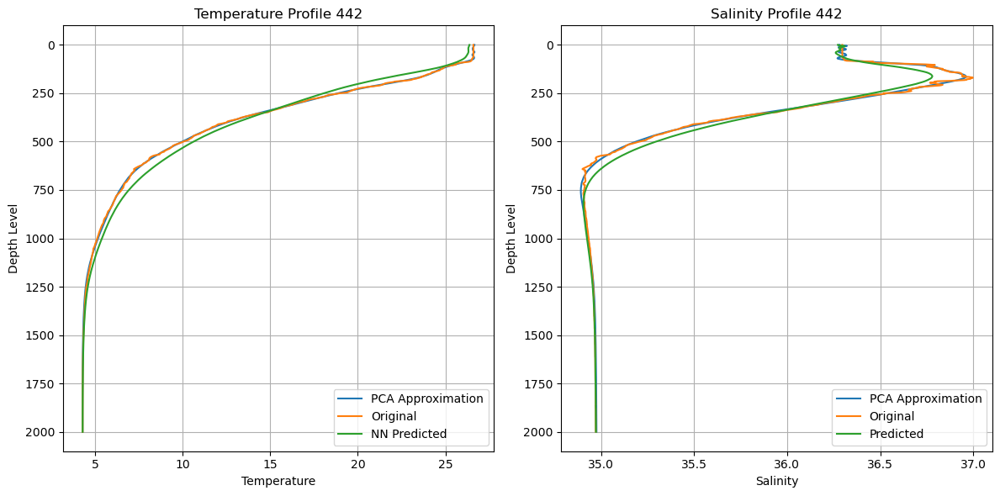

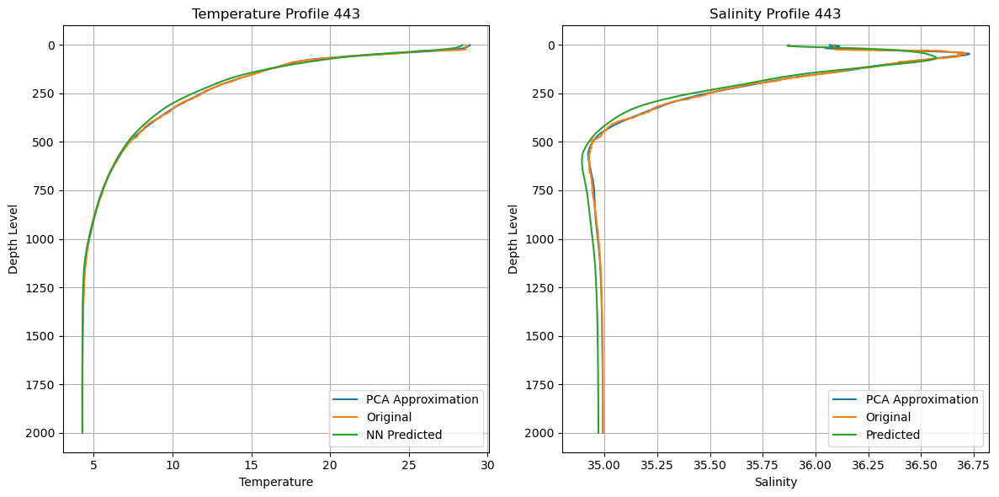

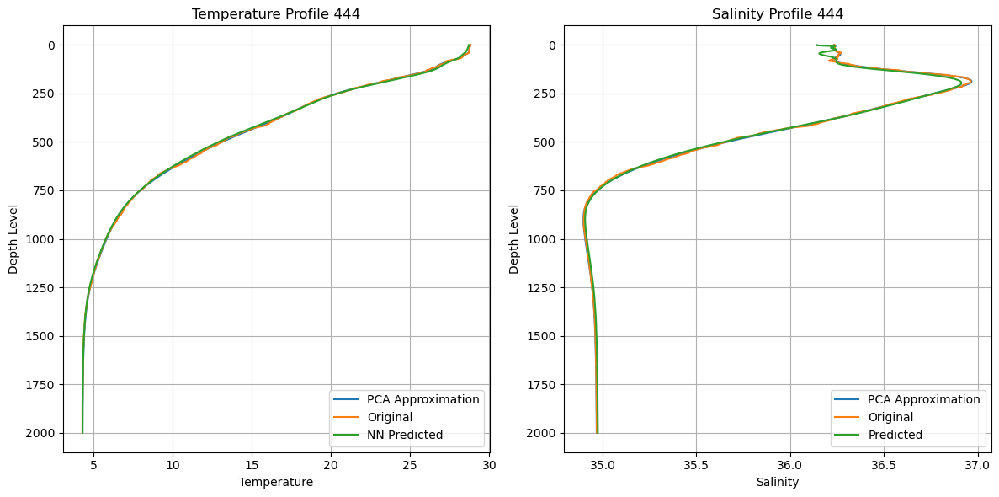


Number of profiles: 4458
Parameters used: sst, ssh
Number of components used: 16 x2
Batch size: 128
Learning rate: 0.001
Dropout probability: 0.2
Train/test/validation split: 0.8/0.1/0.1
Layer configuration: [256, 256]



In [2]:
if __name__ == "__main__":
    # Configurable parameters
    data_path = "/home/jmiranda/SubsurfaceFields/Data/ARGO_GoM_20220920.mat"
    epochs = 500
    patience = 20
    n_components = 16
    batch_size = 128
    learning_rate = 0.001
    dropout_prob = 0.2
    layers_config = [256, 256]
    input_params = {
        "time": False,
        "lat" : False,
        "lon" : False,
        "sss" : False,
        "sst" : True,
        "ssh" : True
    }
    train_size = 0.8
    val_size = 0.1
    test_size = 0.1

    # Load and split data
    full_dataset = TemperatureSalinityDataset(path=data_path, n_components=n_components, input_params=input_params)
    train_dataset, val_dataset, test_dataset = split_dataset(full_dataset, train_size, val_size, test_size)

    # Dataloaders
    train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

    # Compute the input dimension dynamically
    input_dim = sum(val for val in input_params.values())
    model = PredictionModel(input_dim=input_dim, layers_config=layers_config, output_dim=n_components*2, dropout_prob = dropout_prob)
    
    # Check CUDA availability
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=learning_rate)
    
    # print parameters and dataset size
    true_params = [param for param, value in input_params.items() if value]
    def printParams():   
        print(f"\nNumber of profiles: {len(full_dataset)}")
        print("Parameters used:", ", ".join(true_params))
        print(f"Number of components used: {n_components} x2")
        print(f"Batch size: {batch_size}")
        print(f"Learning rate: {learning_rate}")
        print(f"Dropout probability: {dropout_prob}")
        print(f'Train/test/validation split: {train_size}/{test_size}/{val_size}')
        print(f"Layer configuration: {layers_config}\n")
    
    printParams()

    # Training
    trained_model = train_model(model, train_loader, val_loader, criterion, optimizer, device, epochs, patience)
    
    # Test evaluation
    test_loss = evaluate_model(trained_model, test_loader, criterion, device)
    print(f"Test Loss: {test_loss:.4f}")

    # Get predictions for the validation dataset
    val_predictions_pcs = get_predictions(trained_model, val_loader, device)
    # Accessing the original dataset for inverse_transform
    val_predictions = val_dataset.dataset.inverse_transform(val_predictions_pcs)

    subset_indices = val_loader.dataset.indices

    # For original profiles
    original_profiles = val_dataset.dataset.get_profiles(subset_indices, pca_approx=False)

    # For PCA approximated profiles
    pca_approx_profiles = val_dataset.dataset.get_profiles(subset_indices, pca_approx=True)

    num_samples = val_predictions[0].shape[1]
    # Visualize the results for the validation dataset
    visualize_results_with_original(original_profiles, pca_approx_profiles, val_predictions, num_samples=num_samples)

    torch.save(trained_model, "model.pth")
    
    with open("pca_temp.pkl", "wb") as f:
        pickle.dump(full_dataset.pca_temp, f)

    with open("pca_sal.pkl", "wb") as f:
        pickle.dump(full_dataset.pca_sal, f)
        
    printParams()